<a href="https://colab.research.google.com/github/BiancaFormiga/Python-JS-BigData/blob/Aula-03/deteccaoPolichinelo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install mediapipe

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.7/35.7 MB 15.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 10.9 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-metadata 1.15.0 requires protobuf<4.21,>=3.20.3; python_version < "3.11", but you have protobuf 4.25.4 which is incompatible.


ERROR: Could not find a version that satisfies the requirement google-colab-patches (from versions: none)
ERROR: No matching distribution found for google-colab-patches


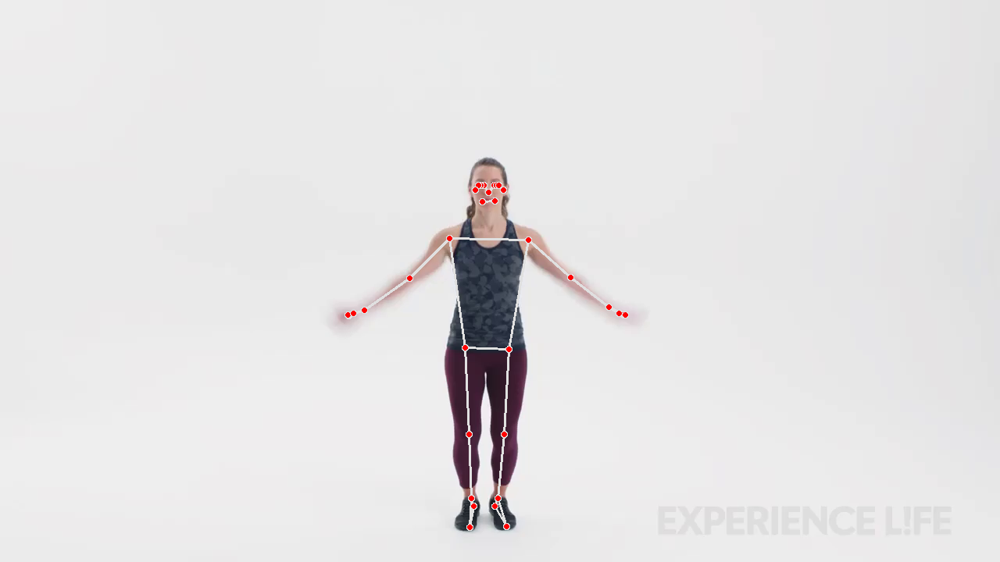

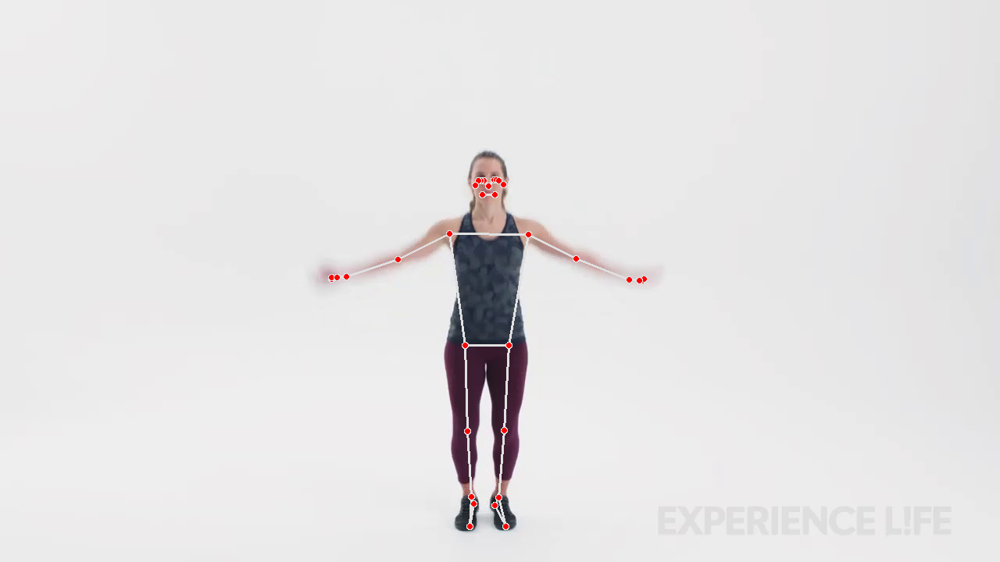

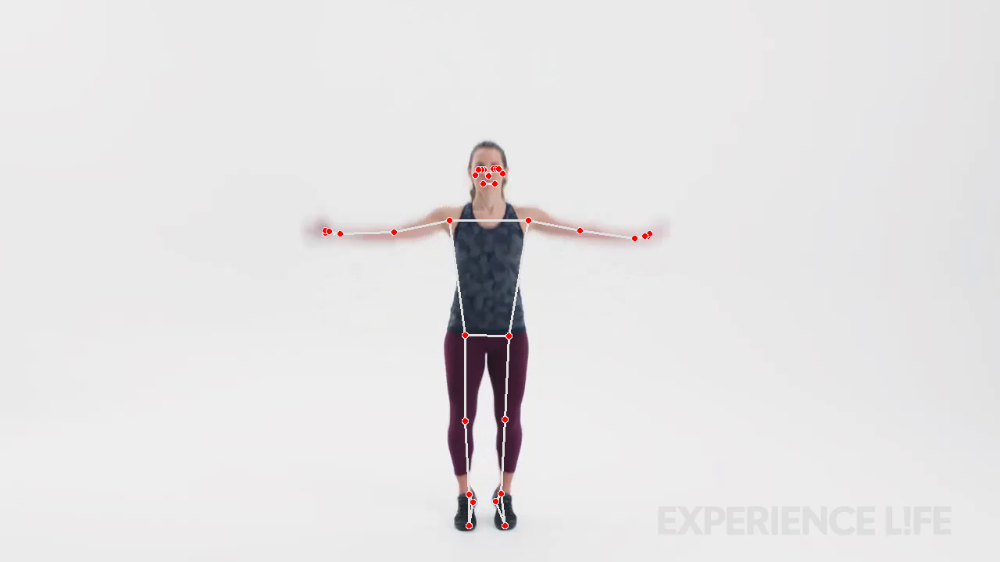

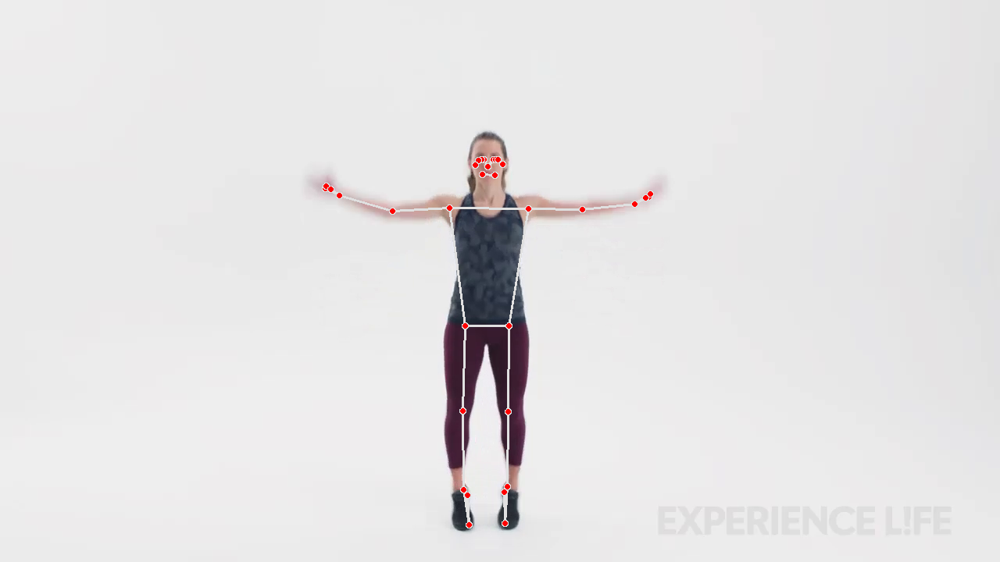

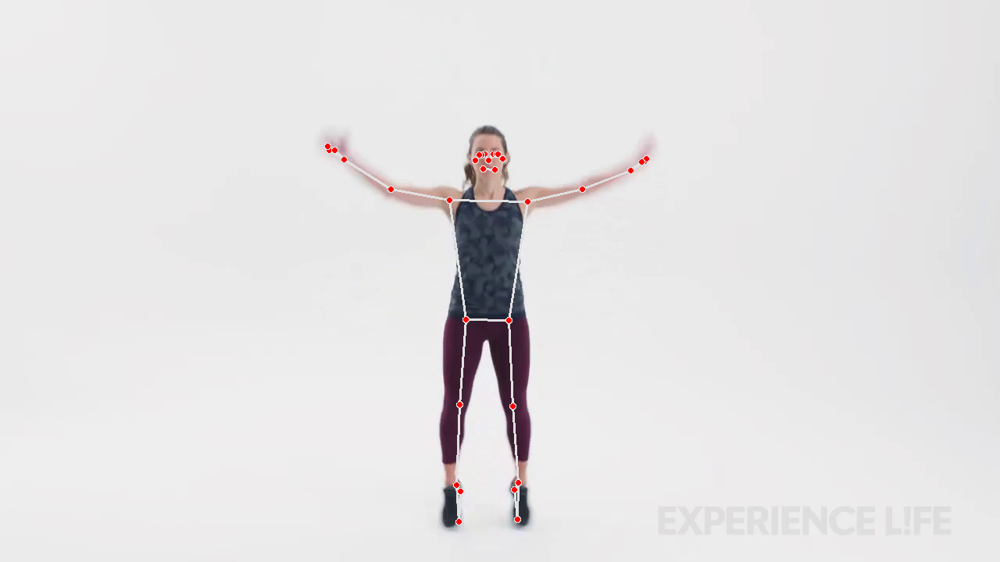

...

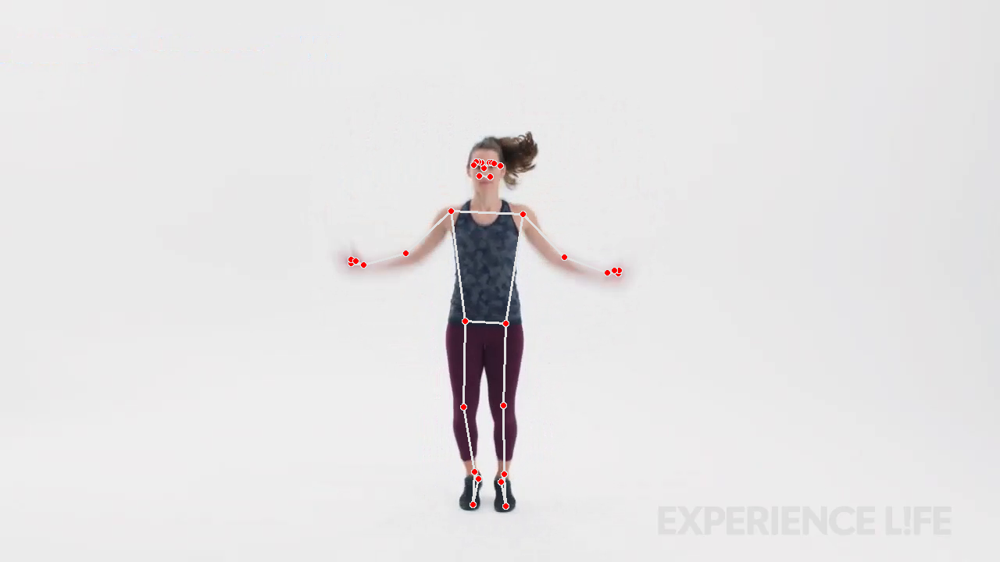

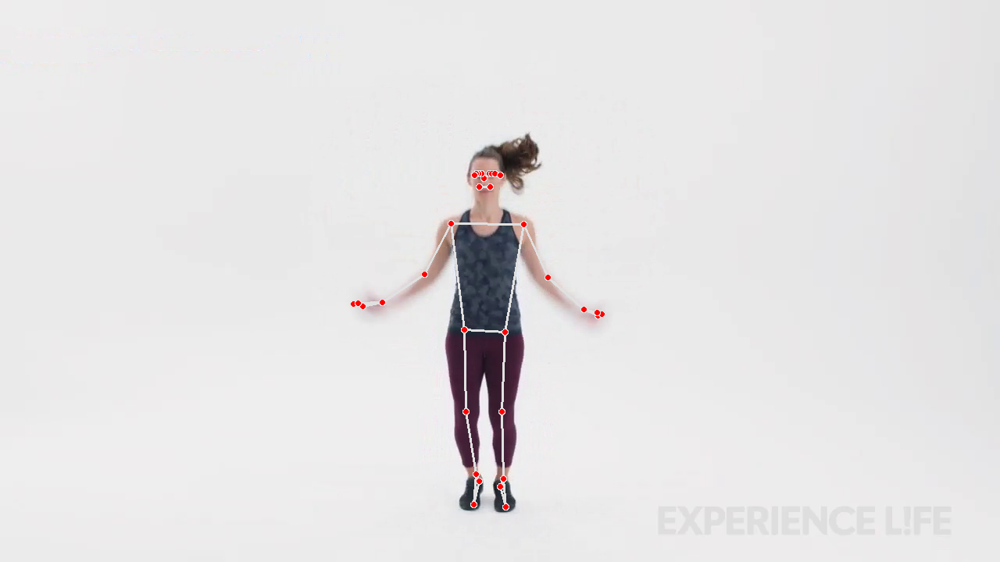

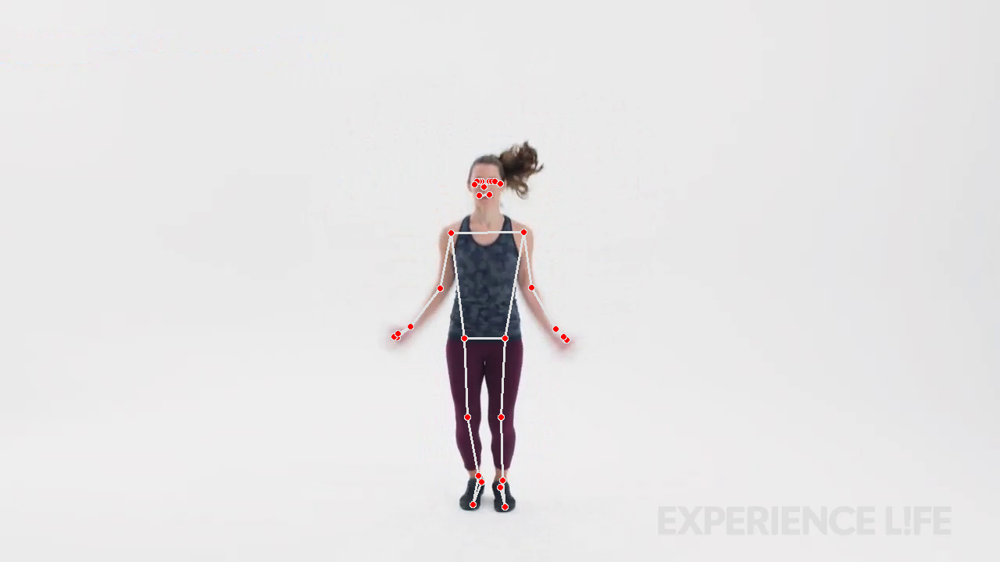

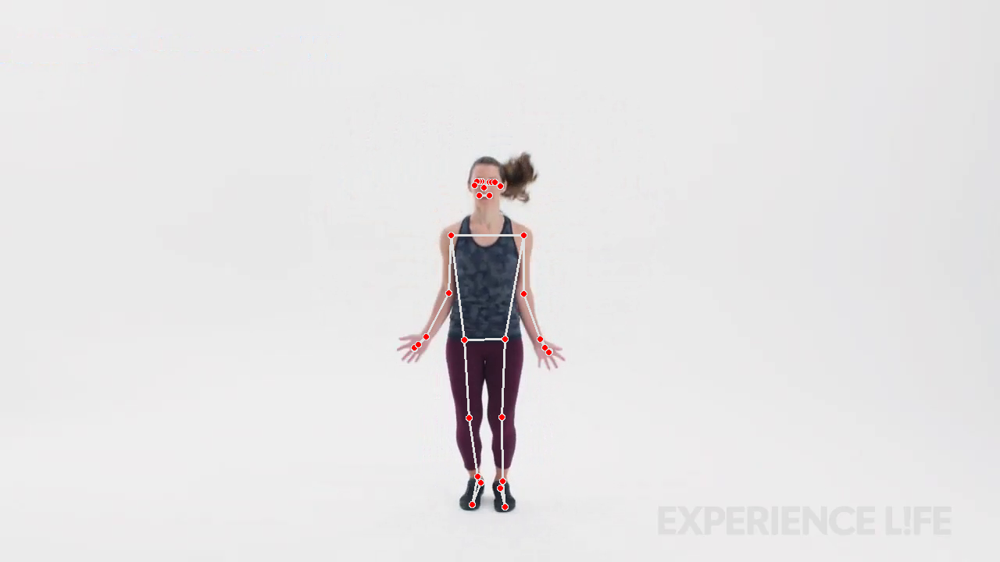

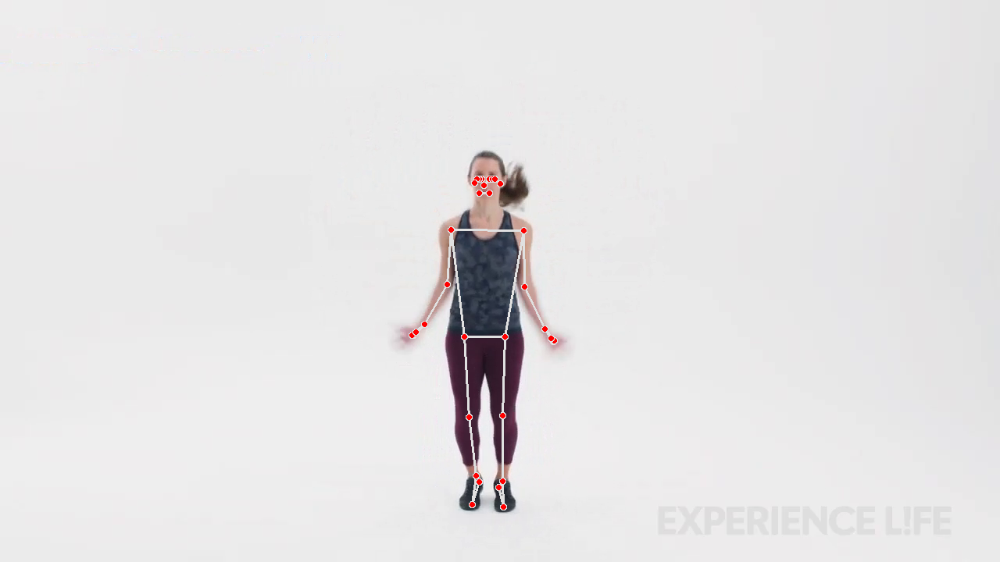

End of video stream.


In [6]:
!pip install google-colab-patches
import cv2
import mediapipe as mp
from google.colab.patches import cv2_imshow # Import the cv2_imshow function

# Make sure the path to your video file is correct
video_path = 'polichinelos.mp4'  # Replace with the actual path
video = cv2.VideoCapture(video_path)

# Check if the video file opened successfully
if not video.isOpened():
    print("Error opening video file. Please check the path.")
    exit()

pose = mp.solutions.pose
Pose = pose.Pose(min_tracking_confidence=0.5, min_detection_confidence=0.5)
draw = mp.solutions.drawing_utils

while True:
    success, img = video.read()

    # Check if a frame was read successfully
    if not success:
        print("End of video stream.")
        break

    videoRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = Pose.process(videoRGB)
    points = results.pose_landmarks
    draw.draw_landmarks(img, points, pose.POSE_CONNECTIONS)

    cv2_imshow(img) # Use cv2_imshow instead of cv2.imshow
    if cv2.waitKey(40) & 0xFF == 27:  # Press 'Esc' to exit
        break

video.release()
cv2.destroyAllWindows()